<h1>Summary</h1>
This contains various things.

In [539]:
using SDDP, Gurobi, LinearAlgebra, Distributions, CSV, DataFrames, Plots, Statistics, StrLiterals

# Problem Data
T = 3  # Total number of years --> 2025, 2030, 2035

# read excel file for load profile
filename = joinpath(@__DIR__, "DH-Capacity-Expansion/LoadProfile.csv")
load_profile = CSV.read(filename, DataFrames.DataFrame, delim=";", decimal = ',')library(MASS)
set.seed(0)
dat <- data.frame(x=rnorm(100), y=rnorm(100, 2))
dens <- kde2d(dat$x, dat$y)
image(dens)
contour(dens, add=T)
load_profile = collect(load_profile[:, "load"])
load_profile_normalized = load_profile ./ sum(load_profile)


8760-element Vector{Float64}:
 0.00024514077660215235
 0.00024488026570215006
 0.0002454881245021554
 0.00024791955980217676
 0.000248180070702179
 0.00024878792950218436
 0.00025026415810219734
 0.00025182722360221106
 0.0002493957883021897
 0.00024670384220216605
 0.0002406252540021127
 0.00023220206760203872
 0.00022464725080197242
 ⋮
 0.0003502135148030749
 0.00034526380730303145
 0.0003429192090030109
 0.0003432665569030139
 0.0003465663619030429
 0.0003489109601030635
 0.0003558579180031244
 0.00036705988760322284
 0.0003766119547033067
 0.00038329840170336536
 0.00038329840170336536
 0.0003766119547033067

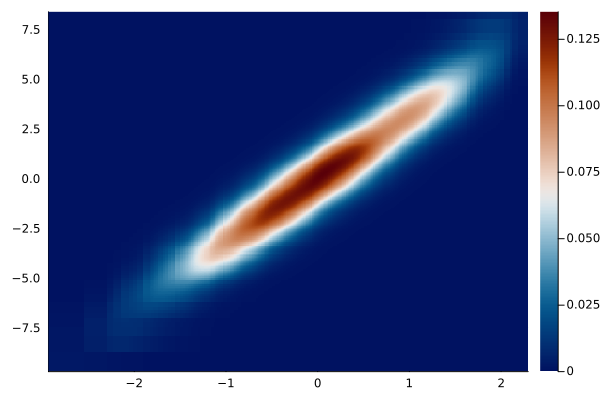

In [772]:
#test heatmap
using KernelDensity
using Interpolations
using Plots

x = sort(randn(500))
y = x * 2.3 + sort(randn(500))

k = kde((x, y))
ik = InterpKDE(k)

z = pdf(ik, x, y)

heatmap(x, y, z, c = :vik)

# savefig("./heatmap.png");

<h1>Typical Days Creation</h1>

In [540]:
profile = load_profile_normalized

n_typical_hours = 10

quants = quantile(profile, LinRange(0,1,n_typical_hours))

diff = (reshape(profile, (size(load_profile)...,1)) .- quants').^2
mindist = argmin(diff, dims = 2)
second_component = getindex.(mindist, 2)


typical_hours = []
for (index,quant) in enumerate(quants)
    typical_hour = Dict(
        :value => quant,
        :qty => count(x -> x == index, second_component)
    )
    
    push!(typical_hours, typical_hour)
end




############## Process electricity prices into typical hours ##################
filename_elec_2030 = joinpath(@__DIR__, "DH-Capacity-Expansion/ElectricityPrice2030.csv")
elec_price_2030 = CSV.read(filename_elec_2030, DataFrames.DataFrame, delim=",", decimal='.')
elec_price_2030 = collect(elec_price_2030[:, "price"])
sale_elec_price_2030 = round.(elec_price_2030, digits=2)
purch_elec_price_2030 = elec_price_2030 .+ 50

filename_elec_2050 = joinpath(@__DIR__, "DH-Capacity-Expansion/ElectricityPrice2050.csv")
elec_price_2050 = CSV.read(filename_elec_2050, DataFrames.DataFrame, delim=",", decimal='.')
elec_price_2050 = collect(elec_price_2050[:, "price"])
sale_elec_price_2050 = round.(elec_price_2050, digits=2)
purch_elec_price_2050 = elec_price_2050 .+ 50

typical_hour_indices = second_component
n_original_hours = length(load_profile)

# Initialize typical electricity prices for 2030 and 2050
c_purch_elec_price_2030_typical = zeros(n_typical_hours)
c_purch_elec_price_2050_typical = zeros(n_typical_hours)
c_sale_elec_price_2030_typical = zeros(n_typical_hours)
c_sale_elec_price_2050_typical = zeros(n_typical_hours)

unique(second_component)
# print(second_component)
sort(unique(second_component))

for i in 1:n_typical_hours
    hours_in_cluster = findall(x -> x == i, typical_hour_indices)
    c_purch_elec_price_2030_typical[i] = mean(purch_elec_price_2030[hours_in_cluster])
    c_purch_elec_price_2050_typical[i] = mean(purch_elec_price_2050[hours_in_cluster])
    c_sale_elec_price_2030_typical[i] = mean(sale_elec_price_2030[hours_in_cluster])
    c_sale_elec_price_2050_typical[i] = mean(sale_elec_price_2050[hours_in_cluster])
end


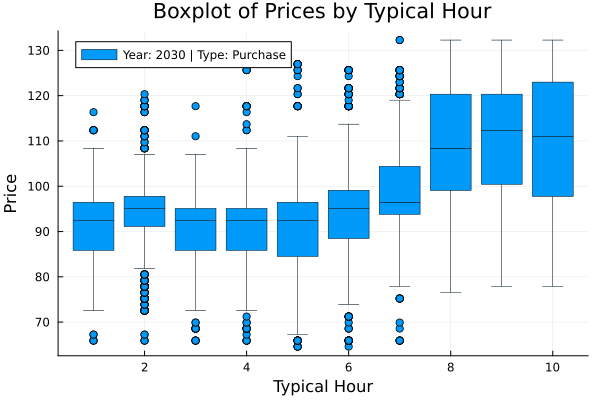

In [541]:
using DataFrames

# Create an empty list to accumulate rows
all_rows = []

# Loop over each typical hour and store all values in the list
for i in 1:n_typical_hours
    hours_in_cluster = findall(x -> x == i, typical_hour_indices)
    
    # Add rows for each combination of Year and Type to the list
    append!(all_rows, [(i, 2030, "Purchase", p) for p in purch_elec_price_2030[hours_in_cluster]])
    append!(all_rows, [(i, 2050, "Purchase", p) for p in purch_elec_price_2050[hours_in_cluster]])
    append!(all_rows, [(i, 2030, "Sale", p) for p in sale_elec_price_2030[hours_in_cluster]])
    append!(all_rows, [(i, 2050, "Sale", p) for p in sale_elec_price_2050[hours_in_cluster]])
end

# Convert the accumulated rows into a DataFrame all at once
df = DataFrame(all_rows, [:TypicalHour, :Year, :Type, :Price])

# Sort DataFrame by TypicalHour and Price if needed
sort!(df, [:TypicalHour, :Price])

# Select the specific year and type you're interested in
selected_year = 2030    # Can be 2030 or 2050
selected_type = "Purchase"  # Can be "Purchase" or "Sale"

# Filter the DataFrame
filtered_df = df[df.Year .== selected_year .&& df.Type .== selected_type, :]

# Create the boxplot
boxplot(filtered_df.TypicalHour, filtered_df.Price, 
        xlabel="Typical Hour", ylabel="Price", 
        title="Boxplot of Prices by Typical Hour", 
        label=string("Year: ", selected_year, " | Type: ", selected_type),
        boxcolor=:lightblue, linewidth=0.5)


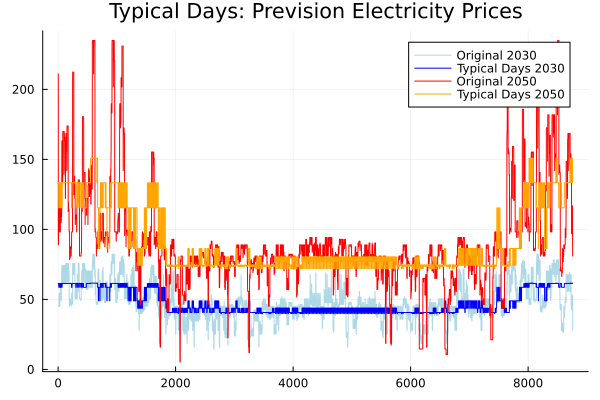

In [546]:

plot(sale_elec_price_2030, label = "Original 2030", c = :lightblue)
plot!(c_sale_elec_price_2030_typical[second_component[:]], label = "Typical Days 2030", c = :blue)
plot!(sale_elec_price_2050, label =  "Original 2050", c = :red)
plot!(c_sale_elec_price_2050_typical[second_component[:]], label =  "Typical Days 2050", c = :orange)
title!("Typical Days: Prevision Electricity Prices")
# savefig("Price_chronology.pdf")

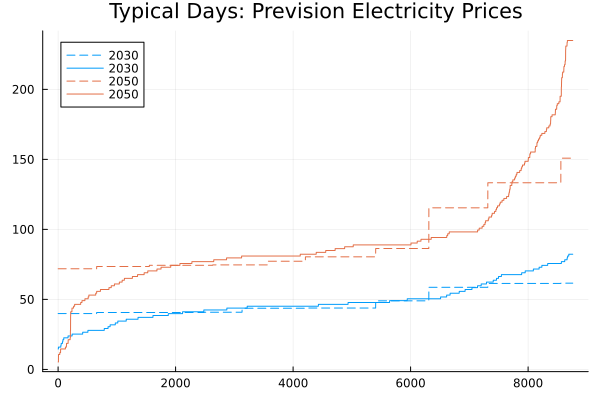

In [548]:
plot(sort(c_sale_elec_price_2030_typical[second_component[:]]), label = "2030", c=1, ls = :dash)
plot!(sort(sale_elec_price_2030), label = "2030", c =1)
plot!(sort(c_sale_elec_price_2050_typical[second_component[:]]), label = "2050", c = 2, ls = :dash)
plot!(sort(sale_elec_price_2050), label = "2050", c =2)

title!("Typical Days: Prevision Electricity Prices")
# savefig("Price_duration.pdf")

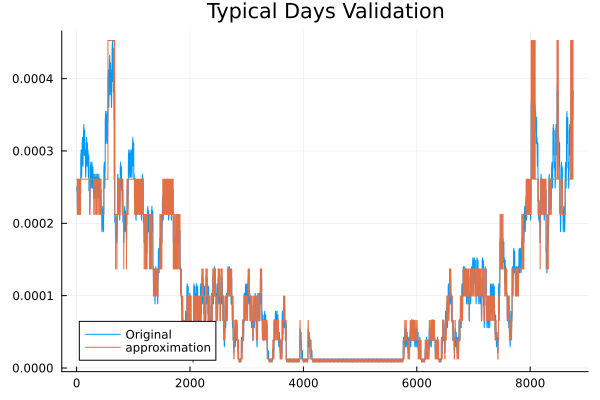

In [550]:
plot(load_profile_normalized, label = "Original", title = "Typical Days Validation")
plot!(quants[second_component[:]], label = "approximation")

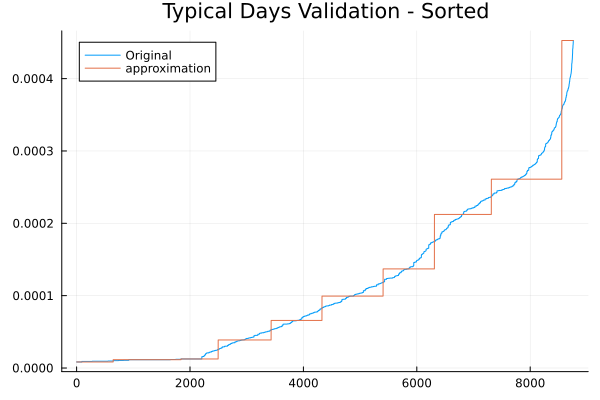

In [552]:

plot(sort(load_profile_normalized), label = "Original", title = "Typical Days Validation - Sorted")
plot!(sort(quants[second_component[:]]), label = "approximation")


<h1>Models</h1>

<h2>Data</h2>
I added the variable initial_cap_dict which you can modify to change the initial capacities and their lifetime. Beware that the capacity you entered should not exceed the value in "lifetime"

In [874]:




# Problem Data
T = 6  # Total number of years --> 2025, 2030, 2035
T_years = 5 # number of years represented by the mmodel years
println("From year 2020 to year $(2020+T*T_years)")
c_hours = 8760

# Base annual demand
base_annual_demand = 2e6 # MWh

# Penalty cost for unmet demand (€/MWh)
c_penalty = 1.0e6

load = load_profile_normalized * base_annual_demand
maximum(load)

# Technological parameters
# Technology Names
technologies = [:CHP, :Boiler, :HeatPump]


# Lifetime in "years" (or pairs of stages)
# e.g., lifetime[:CHP] = 2 means "2 years" of operational usage
lifetime_in_year = Dict(
    :CHP => 20,
    :Boiler => 30,     # e.g. 3-year lifetime => no retirement in 3-year horizon
    :HeatPump => 20,   # only 1-year lifetime => retires quickly
)

lifetime = Dict(
    :CHP       => Int(lifetime_in_year[:CHP]/T_years),
    :Boiler    => Int(lifetime_in_year[:Boiler]/T_years),     # e.g. 3-year lifetime => no retirement in 3-year horizon
    :HeatPump  => Int(lifetime_in_year[:HeatPump]/T_years),   # only 1-year lifetime => retires quickly
)




# You can set Initial Capacities (MW)
function create_initial_cap_dict(technologies::Vector{Symbol}, max_lifetime::Int)
    initial_cap_dict = Dict{Tuple{Symbol, Int}, Int}()
    
    for tech in technologies
        for life in 0:max_lifetime
            initial_cap_dict[(tech, life)] = 0
        end
    end
    
    return initial_cap_dict
end

technologies = [:CHP, :Boiler, :HeatPump]
Max_lifetime = Int(round(lifetime[:Boiler]))+1

initial_cap_dict = create_initial_cap_dict(technologies, Max_lifetime)
initial_cap_dict[:CHP,Int(round(10/T_years))] = 400
initial_cap_dict[:Boiler,Int(round(10/T_years))] = 350
initial_cap_dict[:HeatPump,Int(round(20/T_years))] = 100

# Print dictionary
println(initial_cap_dict)



# Operational Costs (€/MWh)
c_operational_cost = Dict(
    :CHP => 5.0,
    :Boiler => 0.75,
    :HeatPump => 1.1
)

# Investment Costs (€/MW)
c_investment_cost = Dict(
    :CHP => 2048825.0,
    :Boiler => 44528.0,
    :HeatPump => 591052.0
)

# Fixed O&M Costs (€/MW per year)
c_fixed_cost = Dict(
    :CHP => 43297.0,
    :Boiler => 1193.0,
    :HeatPump => 3316.0
)

# Maximum Additional Capacity (MW)
c_max_additional_capacity = Dict(
    :CHP => 500.0,
    :Boiler => 500.0,
    :HeatPump => 500.0
)

c_energy_carrier = Dict(
    :CHP => :nat_gas,
    :Boiler => :nat_gas,
    :HeatPump => :elec
)

# Efficiency (as a fraction)
c_efficiency_th = Dict(
    :CHP => 0.4,
    :Boiler => 0.9,
    :HeatPump => 3.0  # Coefficient of Performance (COP)
)

# Efficiency (as a fraction)
c_efficiency_el = Dict(
    :CHP => 0.5,
    :Boiler => 0.0,
    :HeatPump => 0.0  # Coefficient of Performance (COP)
)

# Emission factors (tCO2/MWh_th)
c_emission_fac = Dict(
    :nat_gas => 0.2,
    :elec => 0,
)


# Operational Costs (€/MWh)
c_opex_var = Dict(
    :CHP => 5.0,
    :Boiler => 0.75,
    :HeatPump => 1.1
)

# Carbon Price (€/t) for years
c_carbon_price = Dict(
    1 => 100,
    2 => 200,
    3 => 300,
    4 => 400,
    5 => 400,
    6 => 400,
    7 => 400,
    8 => 400,
)

# Function to get discount factor for stage t.
#   Each stage is 5 years. If t=1 => 2025, t=2 => 2030, etc.
#   We'll treat "year index" = t (1..T). 
discount_rate = 0.05
function discount_factor(t::Int, T_years::Int)
    # Each stage = 5 years
    exponent = T_years * (ceil(t / 2) - 1)
    return 1.0 / (1.0 + discount_rate)^exponent
end

salvage_fraction = 1

# Define the stochastic demand multipliers: +10%, no change, -10%
demand_multipliers = [1.1, 1.0, 0.9]

# Create a 3x3 identity matrix
I = Diagonal(ones(3))


# Define the matrices that will be repeated
mat1 = [0.3 0.5 0.2; 0.3 0.5 0.2; 0.3 0.5 0.2]  # The repeating matrix
I = Diagonal(ones(3))

# Initialize an empty array to store the matrices
transition_matrices = Array{Float64,2}[]

# Add the first two matrices manually
push!(transition_matrices, [1.0]')
push!(transition_matrices, [1.0]')


push!(transition_matrices, [0.3 0.5 0.2])  # Add the matrix [0.3 0.5 0.2; ...]
push!(transition_matrices, I)     # Add the identity matrix
# Dynamically add the alternating matrices based on T
for i in 1:T-2
    push!(transition_matrices, mat1)  # Add the matrix [0.3 0.5 0.2; ...]
    push!(transition_matrices, I)     # Add the identity matrix
end

println(transition_matrices)

the_iteration_limit = 100


# Log Normal distribution for the energy price
mean_price = 37.0  # Average energy price in currency units per unit of energy
price_volatility = 10.0  # Standard deviation
μ_normal = log(mean_price^2 / sqrt(price_volatility^2 + mean_price^2))
σ_normal = sqrt(log(1 + (price_volatility / mean_price)^2))
price_distribution = LogNormal(μ_normal, σ_normal)
num_price_scenarios = 10
price_quantiles = range(0.05, 0.95; length=num_price_scenarios)
price_values = quantile.(price_distribution, price_quantiles)
price_probabilities = pdf(price_distribution, price_values)
price_probabilities_normalized = price_probabilities / sum(price_probabilities)


From year 2020 to year 2050
Dict((:HeatPump, 3) => 0, (:CHP, 2) => 400, (:CHP, 7) => 0, (:Boiler, 1) => 0, (:HeatPump, 0) => 0, (:HeatPump, 7) => 0, (:HeatPump, 1) => 0, (:Boiler, 5) => 0, (:CHP, 5) => 0, (:Boiler, 4) => 0, (:CHP, 0) => 0, (:CHP, 3) => 0, (:Boiler, 0) => 0, (:HeatPump, 2) => 0, (:Boiler, 2) => 350, (:CHP, 4) => 0, (:Boiler, 6) => 0, (:CHP, 6) => 0, (:Boiler, 7) => 0, (:CHP, 1) => 0, (:HeatPump, 6) => 0, (:HeatPump, 4) => 100, (:Boiler, 3) => 0, (:HeatPump, 5) => 0)
[[1.0;;], [1.0;;], [0.3 0.5 0.2], [1.0 0.0 0.0; 0.0 1.0 0.0; 0.0 0.0 1.0], [0.3 0.5 0.2; 0.3 0.5 0.2; 0.3 0.5 0.2], [1.0 0.0 0.0; 0.0 1.0 0.0; 0.0 0.0 1.0], [0.3 0.5 0.2; 0.3 0.5 0.2; 0.3 0.5 0.2], [1.0 0.0 0.0; 0.0 1.0 0.0; 0.0 0.0 1.0], [0.3 0.5 0.2; 0.3 0.5 0.2; 0.3 0.5 0.2], [1.0 0.0 0.0; 0.0 1.0 0.0; 0.0 0.0 1.0], [0.3 0.5 0.2; 0.3 0.5 0.2; 0.3 0.5 0.2], [1.0 0.0 0.0; 0.0 1.0 0.0; 0.0 0.0 1.0]]


10-element Vector{Float64}:
 0.05517703795550454
 0.10613089994058338
 0.1313937458464863
 0.14183299861367246
 0.1414640921137261
 0.1323320758879828
 0.11558763902083811
 0.09183709042163361
 0.0612083595814727
 0.023036060618100176

<h1>Lifetime model</h1>
I added the "sandwich_cost" in the operational objective stage. It is equal to 0, except when you reach last stage (2*T)
Additonnally, I added +1 in lifetime to asset, and compute their power by summing from 1 to lifetime: in other words, the assets with lifetime+1 are not considered but will be considered at the next investment stage.

In [876]:

##############################################################################
# Create SDDP model
##############################################################################
# Create the Markovian policy graph
model = SDDP.MarkovianPolicyGraph(
    transition_matrices=transition_matrices,
    sense=:Min,
    lower_bound=0.0,  # Set the lower bound
    optimizer=Gurobi.Optimizer
) do sp, node
    t, demand_state = node

    # Variables
    @variables(sp, begin
        0 <= u_expansion_tech[tech in technologies] <= c_max_additional_capacity[tech]
        0 <= u_production_tech[tech in technologies, 1:n_typical_hours]
        0 <= u_unmet[1:n_typical_hours]
        0 <= x_annual_demand,                                                                       SDDP.State, (initial_value = base_annual_demand)
        0 <= cap[tech in technologies, lives in 0:Max_lifetime] <= c_max_additional_capacity[tech], SDDP.State, (initial_value = initial_cap_dict[tech,lives])
    end)

    ################### Investment stage (odd-numbered stages) ###################
    if t % 2 == 1
        @constraint(sp, x_annual_demand.out == x_annual_demand.in)

        for tech in technologies
            for lives in 0:Max_lifetime
                if lives == lifetime[tech] + 1
                    @constraint(sp, cap[tech,lives].out == cap[tech,lives].in + u_expansion_tech[tech]) #Possibility to expand with brand new
                else
                    @constraint(sp, cap[tech,lives].out == cap[tech,lives].in )
                end
                
            end
        end
        local df = discount_factor(t, T_years)
        investme_cost = @expression(sp, sum(c_investment_cost[tech] * u_expansion_tech[tech]     for tech in technologies))
        maintain_cost = @expression(sp, sum(cap[tech, lives].out * c_fixed_cost[tech]            for tech in technologies for lives in 1:lifetime[tech]))
        @stageobjective(sp, df * (investme_cost + T_years * maintain_cost))
                            

        ################### Operational stage (even-numbered stages) ###################
    else
        model_year = Int(ceil(t / 2))
        if t == 2
            d_annual = base_annual_demand
        else
            d_annual = demand_multipliers[demand_state] * x_annual_demand.in
        end

        @constraint(sp, [hour in 1:n_typical_hours], 
            sum(u_production_tech[tech, hour] for tech in technologies) + u_unmet[hour] == d_annual * typical_hours[hour][:value])

        @constraint(sp, [hour in 1:n_typical_hours, tech in technologies],
            u_production_tech[tech, hour] <= sum(cap[tech,lives].in for lives = 1:lifetime[tech])
        )

        # Aging capacity by removing one life.
        @constraint(sp, [tech in technologies, lives in 1:Max_lifetime],
            cap[tech,lives-1].out == cap[tech,lives].in
        )
        @constraint(sp, [tech in technologies],
            cap[tech,Max_lifetime].out == 0
        )
        
        
        # Update annual demand state
        @constraint(sp, x_annual_demand.out == d_annual)
        
        ### Stage objective (operational costs) ###
        SDDP.parameterize(sp, price_values, price_probabilities_normalized) do ω
            # discount factor for this stage
            local df = discount_factor(t, T_years)
            # Determine the relevant electricity purchase and sale price for the current model year
            local purch_elec_price = model_year <= 2 ? c_purch_elec_price_2030_typical : c_purch_elec_price_2050_typical
            local sale_elec_price = model_year <= 2 ? c_sale_elec_price_2030_typical : c_sale_elec_price_2050_typical

            
            # We treat (c_operational_cost[tech] + ω) as the total variable cost
            # operation_cost = sum((c_operational_cost[tech] + ω) * u_production_tech[tech, hour] 
            #     for tech in technologies  for hour in 1:n_typical_hours)
            # unmet_cost = sum(u_unmet[hour] * c_penalty * typical_hours[hour][:qty]  for hour in 1:n_typical_hours)   
            # sandwich_cost = 0
            # if t == 2*T
            #     sandwich_cost = sum(cap[tech,lives].out * c_investment_cost[tech] * lives/lifetime[tech] for tech in technologies for lives in 1:Max_lifetime)
            # end
            # @stageobjective(sp, operation_cost + unmet_cost - sandwich_cost)

            
            local expr_annual_cost = sum(
                (
                    sum(
                        c_opex_var[tech] * u_production_tech[tech, hour] #O&M
                        + (
                            (c_energy_carrier[tech] == :nat_gas ? ω : purch_elec_price[hour]) # random energy price | electricity price
                            + c_carbon_price[model_year] * c_emission_fac[c_energy_carrier[tech]] # carbon price
                            - c_efficiency_el[tech] * sale_elec_price[hour] # electricity revenue
                        )
                        * (u_production_tech[tech, hour] / c_efficiency_th[tech] # primary energy conversion
                        )
                        for tech in technologies
                    )
                    + u_unmet[hour] * c_penalty
                ) * typical_hours[hour][:qty]
                for hour in 1:n_typical_hours)
            local sandwich_cost = 0
            if t == 2*T
                sandwich_cost = sum(cap[tech,lives].out * c_investment_cost[tech] * lives/lifetime[tech] for tech in technologies for lives in 1:Max_lifetime)
            end
            # multiply by the 5-year block and discount factor
            @stageobjective(sp, df * (T_years * expr_annual_cost - sandwich_cost))
        end
    end
end

# Train the model
SDDP.train(model; iteration_limit=100)

# Retrieve results
println("Optimal Cost: ", SDDP.calculate_bound(model))



-------------------------------------------------------------------
         SDDP.jl (c) Oscar Dowson and contributors, 2017-25
-------------------------------------------------------------------
problem
  nodes           : 32
  state variables : 25
  scenarios       : 2.43000e+08
  existing cuts   : false
options
  solver          : serial mode
  risk measure    : SDDP.Expectation()
  sampling scheme : SDDP.InSampleMonteCarlo
subproblem structure
  VariableRef                             : [94, 94]
  AffExpr in MOI.EqualTo{Float64}         : [25, 35]
  AffExpr in MOI.LessThan{Float64}        : [30, 30]
  VariableRef in MOI.GreaterThan{Float64} : [69, 69]
  VariableRef in MOI.LessThan{Float64}    : [27, 28]
numerical stability report
  matrix range     [8e-06, 1e+00]
  objective range  [1e+00, 6e+09]
  bounds range     [5e+02, 5e+02]
  rhs range        [2e+01, 2e+06]
  - matrix range contains small coefficients
  - objective range contains large coefficients
Very large or small absolut

<h2>Simulations</h2>

In [884]:

# Simulation
simulations = SDDP.simulate(model, 1000, [:cap, :x_annual_demand, :u_production_tech, :u_expansion_tech, :u_unmet])

# Print simulation results
for t in 1:(T*2)
    sp = simulations[1][t]
    if t % 2 == 1  # Investment stages (odd stages)
        println("Year $(div(t + 1, 2)) - Investment Stage")
        for tech in technologies
            println("  Technology: $tech")
            println("    Expansion = ", value(sp[:u_expansion_tech][tech]))
            for lives in 0:Max_lifetime
                println("    Capacity $(String(tech)) $lives = ", value(sp[:cap][tech,lives].in))
            end
            
            println("    Expansion = ", value(sp[:u_expansion_tech][tech]))
        end
    else  # Operational stages
        println("Year $(div(t, 2)) - Operational Stage")
        println("   Demand_in = ", value(sp[:x_annual_demand].in))
        println("   Demand_out = ", value(sp[:x_annual_demand].out))
        
        total_production = sum(sum(value(sp[:u_production_tech][tech, hour] * typical_hours[hour][:qty]) for hour in 1:n_typical_hours) for tech in technologies)
        total_unmet = sum(value(sp[:u_unmet][hour] * typical_hours[hour][:qty]) for hour in 1:n_typical_hours)
        println("  Total Production = ", total_production)
        println("  Total Unmet Demand = ", total_unmet)
    end
end


plt = SDDP.SpaghettiPlot(simulations)

for tech in technologies
    SDDP.add_spaghetti(plt; title="Capacity_in_$tech") do data
        return sum(data[:cap][tech, lives].in for lives in 1:Max_lifetime)
    end
    SDDP.add_spaghetti(plt; title="Capacity_out_$tech") do data
        return sum(data[:cap][tech, lives].out for lives in 1:Max_lifetime)
    end
    SDDP.add_spaghetti(plt; title="Expansion_$tech") do data
        return data[:u_expansion_tech][tech]
    end
    SDDP.add_spaghetti(plt; title="Production_$tech") do data
        return sum(data[:u_production_tech][tech, :])
    end
end


SDDP.add_spaghetti(plt; title="Annual Demand_in") do data
    return data[:x_annual_demand].in
end
SDDP.add_spaghetti(plt; title="Annual Demand_out") do data
    return data[:x_annual_demand].out
end
SDDP.add_spaghetti(plt; title="Total Production") do data
    return sum(sum((data[:u_production_tech][tech, hour] * typical_hours[hour][:qty]) for hour in 1:n_typical_hours) for tech in technologies)
end
SDDP.add_spaghetti(plt; title="Unmet Demand") do data
    return sum(data[:u_unmet])
end

# SDDP.plot(plt, "spaghetti_plot.html")

Year 1 - Investment Stage
  Technology: CHP
    Expansion = 0.0
    Capacity CHP 0 = 0.0
    Capacity CHP 1 = 0.0
    Capacity CHP 2 = 400.0
    Capacity CHP 3 = 0.0
    Capacity CHP 4 = 0.0
    Capacity CHP 5 = 0.0
    Capacity CHP 6 = 0.0
    Capacity CHP 7 = 0.0
    Expansion = 0.0
  Technology: Boiler
    Expansion = 85.5047850886645
    Capacity Boiler 0 = 0.0
    Capacity Boiler 1 = 0.0
    Capacity Boiler 2 = 350.0
    Capacity Boiler 3 = 0.0
    Capacity Boiler 4 = 0.0
    Capacity Boiler 5 = 0.0
    Capacity Boiler 6 = 0.0
    Capacity Boiler 7 = 0.0
    Expansion = 85.5047850886645
  Technology: HeatPump
    Expansion = 369.8574979139811
    Capacity HeatPump 0 = 0.0
    Capacity HeatPump 1 = 0.0
    Capacity HeatPump 2 = 0.0
    Capacity HeatPump 3 = 0.0
    Capacity HeatPump 4 = 100.0
    Capacity HeatPump 5 = 0.0
    Capacity HeatPump 6 = 0.0
    Capacity HeatPump 7 = 0.0
    Expansion = 369.8574979139811
Year 1 - Operational Stage
   Demand_in = 2.0e6
   Demand_out = 2.0e

<h2>Visualization</h2>

[:Boiler, :HeatPump, :CHP]
 Boiler 1.1240189529813158e6
 Boiler 153300.01127241802
 Boiler 77809.57556608817
 Boiler 77809.5755661188
 Boiler 77809.57556608369
 Boiler 77809.57556608251
 HeatPump 659907.7214741223
 HeatPump 1.8126406164390547e6
 HeatPump 1.8881310530396614e6
 HeatPump 1.8881310530396302e6
 HeatPump 1.8881310530396658e6
 HeatPump 1.888131053039667e6
 CHP 170775.40980649774
 CHP 0.000894276613337297
 CHP 0.0
 CHP 0.0
 CHP 0.0
 CHP 0.0


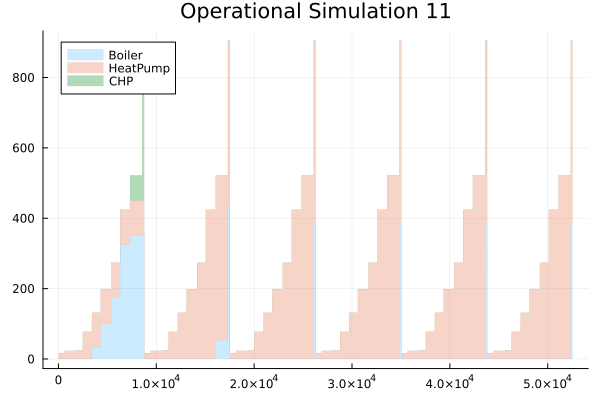

In [885]:

colors = Dict

n_sim = 11


plt = plot(title = "Operational Simulation $n_sim")
y0 = zeros(8760*T, length(technologies))
labels = Vector{String}()

sorted_keys = sort(collect(c_operational_cost), by = x -> x[2])  # Sort by value
enumerated_keys = [pair[1] for pair in sorted_keys]  # Extract sorted keys
println(enumerated_keys)
for (index,tech) in enumerate(enumerated_keys)
    for t_prim in 1:(T)
        t = 2 * t_prim
        sp = simulations[n_sim][t]
        total_unmet = sum(value(sp[:u_unmet][hour]  * typical_hours[hour][:qty]) for hour in 1:n_typical_hours)
        y0[1+8760*(t_prim-1):8760*t_prim,index] = sort(Array(values(sp[:u_production_tech][tech,:]))[second_component[:]])
        prod_tot = (sum(Array(values(sp[:u_production_tech][tech,:]))[second_component[:]]))
        # vline(1+8760*(t_prim-1))
        print(" $(tech) $(prod_tot)" )
        println()
    end
    
    push!(labels, String(tech))
end
# print(labels)
# labels = string.(Any["CHP", "HeatPump", "Boiler"])
# println(hcat(labels))
areaplot!(y0,label = Matrix(reshape(labels,1,length(labels))),fillalpha = [0.2 0.3 0.4], lw = 0)


display(plt)


[8.987499091797646 9.943061009305165 86.74233174548286 38.20814795421167 18.28129453097558; 81.05843491006175 85.97521815726708 57.275641438987094 13.763702813866052 26.310656156255476; 81.83100749621994 84.7782413444595 20.626530286290677 70.2196825258106 73.92592024704754; 27.859472633636695 86.83956726270179 84.40890417235659 13.114419019993184 78.68513065981655; 2.148307804777183 84.0226917204911 63.54088043198686 90.7978318059174 24.494222594658666; 46.72486195611438 52.21609217450967 54.49650616088678 67.7585140152431 75.12687920197153; 1.373392914959315 72.85797418085704 87.10023235205644 70.53321750024467 79.58387333502277; 65.13705058178024 76.04866852032104 90.9821827010741 81.681295153407 75.89303146792493; 73.17765856160527 79.62929339537958 28.296030191239694 68.46079307117901 73.8033990519261; 68.145896936885 6.243118411391202 32.08477674064765 99.64007254383932 21.174160516903974]

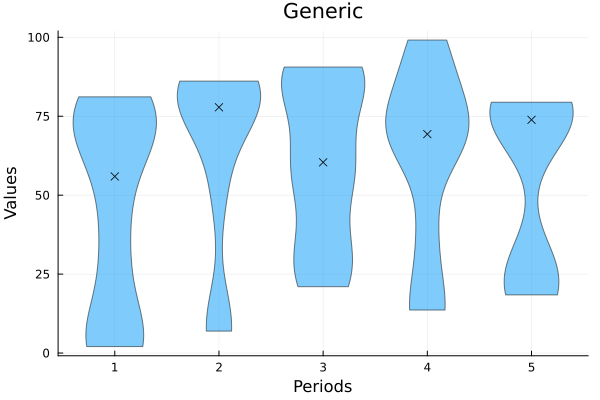

In [894]:

# Sample matrix: 10 rows (observations) and 5 columns (stages)
data = rand(10, 5) * 100  # Replace with your actual matrix
print(data)


function plot_bands(data, title,xlabels)
    # Compute statistics for each column (apply quantile to each column)
    x_values = xlabels  # Column indices as x-axis
    q5 =  [quantile(data[:, i], 0.05) for i in 1:size(data, 2)]
    q25 = [quantile(data[:, i], 0.25) for i in 1:size(data, 2)]
    q50 = [quantile(data[:, i], 0.50) for i in 1:size(data, 2)]  # Median (50th percentile)
    q75 = [quantile(data[:, i], 0.75) for i in 1:size(data, 2)]
    q95 = [quantile(data[:, i], 0.95) for i in 1:size(data, 2)]
    
    # Create plot
    plot(x_values, q5, fillrange = q95, fillalpha = 0.15,  c = 2, label = "5-95", legend = :topleft,lw = 0)
    plot!(x_values, q25, fillrange = q75, fillalpha = 0.35, c = 2, label = "25-75", legend = :topleft,lw = 0)
    plot!(x_values, q95, fillalpha = 0.15,  c = 2, label = "", legend = :topleft,lw = 0)
    plot!(x_values, q75, fillalpha = 0.35, c = 2, label = "", legend = :topleft,lw = 0)
    plot!(x_values, q50, label="Median (50th Percentile)", lw=2, color=2)  # Median line
    
    # Labels and title
    xlabel!("Periods")
    ylabel!("Values")
    title!(title)
    # display()
end

plot_bands(data,"Generic", 1:5)

6
[2.0e6, 2.0e6, 2.0e6, 2.0e6, 2.0e6, 2.1562200000000005e6][1.1240189529813158e6, 153300.01127241802, 77809.57556608817, 77809.57556608817, 84734.62779146504, 84734.62779146514][170775.40980649774, 0.000894276613337297, 0.0, 0.0, 0.0, 0.0][659907.7214741223, 1.8126406164390547e6, 1.8881310530396614e6, 1.8881310530396614e6, 1.8881310530396658e6, 1.9616247914475515e6]

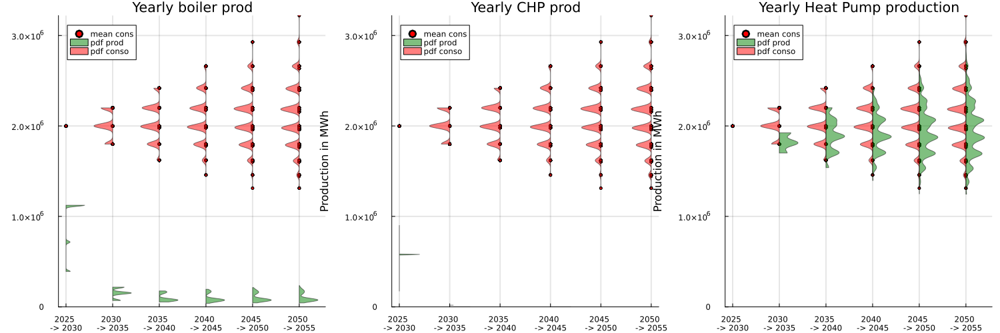

In [978]:
length(simulations)
println(T)

variable = :x_annual_demand
ope_var = zeros(length(simulations), T)

xlabels = []

for (ope_stage, stage) in enumerate(2:2:2*T)
    push!(xlabels, 2010 + ope_stage*10)
    for sim in 1:length(simulations)
        # println("$ope_stage $stage")
        # print(simulations[n_sim][stage][:x_annual_demand])
        ope_var[sim,ope_stage] = values(simulations[sim][stage][:x_annual_demand].out)
    end
end




function plot_bands(data, title,xlabels,y_legend)
    # Compute statistics for each column (apply quantile to each column)
    x_values = xlabels  # Column indices as x-axis
    q5 =  [quantile(data[:, i], 0.05) for i in 1:size(data, 2)]
    q25 = [quantile(data[:, i], 0.25) for i in 1:size(data, 2)]
    q50 = [quantile(data[:, i], 0.50) for i in 1:size(data, 2)]  # Median (50th percentile)
    q75 = [quantile(data[:, i], 0.75) for i in 1:size(data, 2)]
    q95 = [quantile(data[:, i], 0.95) for i in 1:size(data, 2)]
    print(q50)
    # Create plot
    h = plot(x_values, q50, label="Median (50th Percentile)", lw=2, color=2)  # Median line
    plot!(x_values, q5, fillrange = q95, fillalpha = 0.15,  c = 2, label = "p5-p95", legend = :topleft,lw = 0)
    plot!(x_values, q25, fillrange = q75, fillalpha = 0.35, c = 2, label = "p25-p75", legend = :topleft,lw = 0)
    plot!(x_values, q95, fillalpha = 0.15,  c = 2, label = "", legend = :topleft,lw = 0)
    plot!(x_values, q75, fillalpha = 0.35, c = 2, label = "", legend = :topleft,lw = 0)
    plot!(gridlinewidth = 2)
    
    # Labels and title
    xlabel!("Periods")
    ylabel!(y_legend)
    title!(title)
    return(h)
end

function plot_violins(data, title,xlabels,y_legend)
    
    # Prepare data for violin plot
    group_labels = repeat(xlabels, inner=size(data, 1))  # Repeat each x-axis label for each data point
    flattened_values = vec(data)  # Flatten the matrix into a single vector
    
    # Overlay means points for each group
    group_means = [mean(data[:, i]) for i in 1:size(data, 2)]
    scatter(group_labels, flattened_values, color=:black, markershape=:o, label="samples", markersize = 2)
    # Create violin plot
    violin!(group_labels, flattened_values, 
           xlabel="Periods", title=title, label = "pdf",
           legend=true, alpha=0.5, c = :green)
    plot!(gridlinewidth = 2)
    scatter!(xlabels, group_means, color=:red, markershape=:o, label="Mean")
    
    ylabel!(y_legend)

end

function plot_combined_violins(data1,data2, title,xlabels,y_legend)
    
    # Prepare data for violin plot
    group_labels = repeat(xlabels, inner=size(data1, 1))  # Repeat each x-axis label for each data point
    flattened_values_1 = vec(data1)  # Flatten the matrix into a single vector
    flattened_values_2 = vec(data2)  # Flatten the matrix into a single vector
    
    # Overlay means points for each group
    group_means = [mean(data2[:, i]) for i in 1:size(data, 2)]
    scatter(group_labels, flattened_values_2, color=:red, markershape=:o, label="mean cons", markersize = 2, lw = 0)
    # Create violin plot
    violin!(group_labels, flattened_values_1, 
           xlabel="Periods", title=title, label = "pdf prod",
           legend=true, alpha=0.5, c = :green, side=:right)
    # dotplot!(group_labels, flattened_values_1, side=:right, color=:green, markershape=:o, label="samples", markersize = 2)
    # Create violin plot
    violin!(group_labels, flattened_values_2, 
           xlabel="Periods", title=title, label = "pdf conso",
           legend=true, alpha=0.5, c = :red, side=:left)
    plot!(gridlinewidth = 2)
    # scatter!(xlabels, group_means, color=:red, markershape=:o, label="Mean")
    
    ylabel!(y_legend)

end

plot_bands(data,"Generic", 1:5)

ope_var_cons = zeros(length(simulations), T)
# (sum(Array(values(data[:u_production_tech][:CHP,:]))[second_component[:]]))

# plot_bands(ope_var, "Annual demand", xlabels)
# savefig("Demand Evolution.pdf")

##### DEMAND ###############
xlabels = []
for (ope_stage, stage) in enumerate(2:2:2*T)
    push!(xlabels, "$(2020 + ope_stage*T_years) \n-> $(2020 + (ope_stage+1)*T_years )")
    for sim in 1:length(simulations)
        ope_var_cons[sim,ope_stage] = values(simulations[sim][stage][:x_annual_demand].out)
    end
end

upper_bound = maximum(ope_var)
q = plot_violins(ope_var_cons, "Yearly demand", xlabels,"Demand in MWh")
# display(q)
savefig("Violin_plots.pdf")
# stop()

p = plot_bands(ope_var_cons, "Yearly demand", xlabels,"Demand in MWh")
plot!(ylim = (0,upper_bound))
# display(p)

############################### PRODUCTION - SOLID LINES ##########################
xlabels = []
for (ope_stage, stage) in enumerate(2:2:2*T)
    push!(xlabels, "$(2020 + ope_stage*T_years) \n-> $(2020 + (ope_stage+1)*T_years )")
    for sim in 1:length(simulations)
        ope_var[sim,ope_stage] = (sum(Array(values(simulations[sim][stage][:u_production_tech][:Boiler,:]))[second_component[:]]))
    end
end

p1 = plot_bands(ope_var, "Yearly boiler prod", xlabels,"Production in MWh")
plot!(ylim = (0,upper_bound))
for (ope_stage, stage) in enumerate(2:2:2*T)
    for sim in 1:length(simulations)
        ope_var[sim,ope_stage] = (sum(Array(values(simulations[sim][stage][:u_production_tech][:CHP,:]))[second_component[:]]))
    end
end

p2 = plot_bands(ope_var, "Yearly CHP prod", xlabels,"Production in MWh")
plot!(ylim = (0,upper_bound))

for (ope_stage, stage) in enumerate(2:2:2*T)
    for sim in 1:length(simulations)
        ope_var[sim,ope_stage] = (sum(Array(values(simulations[sim][stage][:u_production_tech][:HeatPump,:]))[second_component[:]]))
    end
end

p3 = plot_bands(ope_var, "Yearly Heat Pump production", xlabels,"Production in MWh")
plot!(ylim = (0,upper_bound))
plot!(size=(1500,500))
l = @layout [a b c]
h = plot(p1,p2,p3, layout = l)
savefig("Production_solid_lines.pdf")
# display(h)


############################### PRODUCTION - VIOLIN LINES ##########################
xlabels = []
for (ope_stage, stage) in enumerate(2:2:2*T)
    push!(xlabels, "$(2020 + ope_stage*T_years) \n-> $(2020 + (ope_stage+1)*T_years )")
    for sim in 1:length(simulations)
        ope_var[sim,ope_stage] = (sum(Array(values(simulations[sim][stage][:u_production_tech][:Boiler,:]))[second_component[:]]))
    end
end

q1 = plot_combined_violins(ope_var, ope_var_cons,"Yearly boiler prod", xlabels,"Production in MWh")
plot!(ylim = (0,upper_bound))
for (ope_stage, stage) in enumerate(2:2:2*T)
    for sim in 1:length(simulations)
        ope_var[sim,ope_stage] = (sum(Array(values(simulations[sim][stage][:u_production_tech][:CHP,:]))[second_component[:]]))
    end
end

q2 = plot_combined_violins(ope_var, ope_var_cons, "Yearly CHP prod", xlabels,"Production in MWh")
plot!(ylim = (0,upper_bound))

for (ope_stage, stage) in enumerate(2:2:2*T)
    for sim in 1:length(simulations)
        ope_var[sim,ope_stage] = (sum(Array(values(simulations[sim][stage][:u_production_tech][:HeatPump,:]))[second_component[:]]))
    end
end

q3 = plot_combined_violins(ope_var, ope_var_cons,"Yearly Heat Pump production", xlabels,"Production in MWh")
plot!(ylim = (0,upper_bound))
plot!(size=(1500,500))
l = @layout [a b c]
q = plot(q1,q2,q3, layout = l)
savefig("Production_violinplots.pdf")
display(q)

In [477]:

function even_elements_at_even_indices(arr)
    println(arr)
    return [arr[i] for i in 2:2:length(arr) if arr[i] % 2 == 0]
end

println(simulations)

Plots.plot(
    SDDP.publication_plot(simulations; title = "Demand in") do data
        even_elements_at_even_indices(data[:x_annual_demand].out)
        return data[:x_annual_demand].out
    end,
    SDDP.publication_plot(simulations; title = "CHP Production") do data
        return (sum(Array(values(data[:u_production_tech][:CHP,:]))[second_component[:]]))
    end;
    xlabel = "Stage",
    # ylims = (0, 200),
    layout = (1, 2),
)

Vector{Dict{Symbol, Any}}[[Dict(:bellman_term => 3.1940977967124224e8, :node_index => (1, 1), :objective_state => nothing, :belief => Dict((1, 1) => 1.0), :stage_objective => 65300.0, :cap => 2-dimensional DenseAxisArray{SDDP.State{Float64},2,...} with index sets:
    Dimension 1, [:CHP, :Boiler, :HeatPump]
    Dimension 2, 0:5
And data, a 3×6 Matrix{SDDP.State{Float64}}:
 SDDP.State{Float64}(0.0, 0.0)  SDDP.State{Float64}(20.0, 20.0)  SDDP.State{Float64}(0.0, 0.0)  SDDP.State{Float64}(0.0, 0.0)   SDDP.State{Float64}(0.0, 0.0)  SDDP.State{Float64}(0.0, 5.0)
 SDDP.State{Float64}(0.0, 0.0)  SDDP.State{Float64}(20.0, 20.0)  SDDP.State{Float64}(0.0, 0.0)  SDDP.State{Float64}(0.0, 10.0)  SDDP.State{Float64}(0.0, 0.0)  SDDP.State{Float64}(0.0, 0.0)
 SDDP.State{Float64}(0.0, 0.0)  SDDP.State{Float64}(20.0, 20.0)  SDDP.State{Float64}(0.0, 0.0)  SDDP.State{Float64}(0.0, 30.0)  SDDP.State{Float64}(0.0, 0.0)  SDDP.State{Float64}(0.0, 0.0), :u_expansion_tech => 1-dimensional DenseAxisArray{Float64

Excessive output truncated after 524294 bytes.

2-dimensional DenseAxisArray{Float64,2,...} with index sets:
    Dimension 1, [:CHP, :Boiler, :HeatPump]
    Dimension 2, Base.OneTo(10)
And data, a 3×10 Matrix{Float64}:
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0, :u_unmet => [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]), Dict(:bellman_term => 80840.71601742506, :node_index => (8, 2), :objective_state => nothing, :belief => Dict((8, 2) => 1.0), :stage_objective => 9223.320301420215, :cap => 2-dimensional DenseAxisArray{SDDP.State{Float64},2,...} with index sets:
    Dimension 1, [:CHP, :Boiler, :HeatPump]
    Dimension 2, 0:5
And data, a 3×6 Matrix{SDDP.State{Float64}}:
 SDDP.State{Float64}(0.0, 0.0)    SDDP.State{Float64}(0.0, 5.0)                SDDP.State{Float64}(5.0, 0.251861051479097)  SDDP.State{Float64}(0.251861051479097, 5.0)  SDDP.State{Float64}(5.0, 0.0)  SDDP.State{Float64}(0.0, 0.0)
 SDDP.State{Float64}(10.0, 1

LoadError: BoundsError: attempt to access 10-element Vector{Float64} at index [[849, 847, 852, 862, 864, 868, 874, 879, 871, 859  …  968, 968, 971, 973, 976, 982, 986, 988, 988, 986]]

<h1>Old models</h1>
<h2>Model without typical days</h2>

In [12]:

t1 = time()

# the code below prints the markovian graph
SDDP.MarkovianGraph(transition_matrices)

# Create the Markovian policy graph
model = SDDP.MarkovianPolicyGraph(
    transition_matrices=transition_matrices,
    sense=:Min,
    lower_bound=0.0,  # Set the lower bound
    optimizer=Gurobi.Optimizer
) do sp, node
    # Unpack stage and demand state (t is stage, demand_state is 1, 2, or 3)
    t, demand_state = node

    # Variables
    @variables(sp, begin
        # Capacity State Variables for each technology
        0 <= x_capacity_tech[tech in technologies] <= 1000, SDDP.State, (initial_value = c_initial_capacity[tech])
        # Investment pipeline.
        #   pipeline.out are the investments made in the current stage
        #   pipeline.in are the investments that becomes available at this stage
        #     and can be added to the capacity.
        #   Investments move up one slot in the pipeline each stage.
        # Pipeline State Variables for each technology
        0 <= pipeline_tech[tech in technologies] <= c_max_additional_capacity[tech], SDDP.State, (initial_value = 0)
        # Investment Decision Variables for each technology
        0 <= u_expansion_tech[tech in technologies] <= c_max_additional_capacity[tech]
        # Production Variables for each technology
        u_production_tech[tech in technologies, 1:c_hours] >= 0
        # Demand state
        0 <= x_annual_demand, SDDP.State, (initial_value = base_annual_demand)
        # Unmet demand per hour
        u_unmet[1:c_hours] >= 0
    end)

    ################### Investment stage (odd-numbered stages) ###################
    if t % 2 == 1
        # Update capacity without adding pipeline contributions
        @constraint(sp, [tech in technologies], x_capacity_tech[tech].out == x_capacity_tech[tech].in)
        # Maintain annual demand state
        @constraint(sp, x_annual_demand.out == x_annual_demand.in)
        # Add the expansion decision to the pipeline for each technology
        @constraint(sp, [tech in technologies], pipeline_tech[tech].out == u_expansion_tech[tech])
        # Stage objective: expansion cost
        @stageobjective(sp, 
        sum(c_investment_cost[tech] * u_expansion_tech[tech] for tech in technologies) +
        sum(c_fixed_cost[tech] * x_capacity_tech[tech].out for tech in technologies)
        )

    ################### Operational stage (even-numbered stages) ###################
    else
        # ensure that annual demand is not changed in the first year
        if t == 2
            d_annual = base_annual_demand
        else
            # Annual demand adjustment based on the stochastic demand state
            d_annual = demand_multipliers[demand_state] * x_annual_demand.in
        end

        # Apply constraints for production and unmet demand based on the stochastic annual demand
        for hour in 1:c_hours
            actual_demand = d_annual * load_profile_normalized[hour]
        
            # Total production from all technologies plus unmet demand meets the actual demand
            @constraint(sp, sum(u_production_tech[tech, hour] for tech in technologies) + u_unmet[hour] == actual_demand)
        
            # Capacity constraints for each technology
            @constraint(sp, [tech in technologies], u_production_tech[tech, hour] <= x_capacity_tech[tech].in)
        end

        # Update capacity with the investments in the pipeline  for each technology
        @constraint(sp, [tech in technologies], x_capacity_tech[tech].out == x_capacity_tech[tech].in + pipeline_tech[tech].in) 

        # Update annual demand state
        @constraint(sp, x_annual_demand.out == d_annual)

        # Reset the pipeline for each technology
        @constraint(sp, [tech in technologies], pipeline_tech[tech].out == 0)

        # Stage objective (operational costs)
        SDDP.parameterize(sp, price_values, price_probabilities_normalized) do ω
            # We treat (c_operational_cost[tech] + ω) as the total variable cost
            @stageobjective(sp,
                sum((c_operational_cost[tech] + ω) * u_production_tech[tech, hour]
                    for tech in technologies, hour in 1:c_hours ) +
                sum(u_unmet[hour] * c_penalty for hour in 1:c_hours)
            )
        end
    end
end

# Train the model
SDDP.train(model; iteration_limit=the_iteration_limit)

# Retrieve results
println("Optimal Cost: ", SDDP.calculate_bound(model))

# Simulation
simulations = SDDP.simulate(model, 100, [:x_capacity_tech, :x_annual_demand, :u_production_tech, :u_expansion_tech, :u_unmet])

# Print simulation results
for t in 1:(T*2)
    sp = simulations[1][t]
    if t % 2 == 1  # Investment stages (odd stages)
        println("Year $(div(t + 1, 2)) - Investment Stage")
        for tech in technologies
            println("  Technology: $tech")
            println("    Capacity_in = ", value(sp[:x_capacity_tech][tech].in))
            println("    Expansion = ", value(sp[:u_expansion_tech][tech]))
            println("    Capacity_out = ", value(sp[:x_capacity_tech][tech].out))
        end
    else  # Operational stages
        println("Year $(div(t, 2)) - Operational Stage")
        println("   Demand_in = ", value(sp[:x_annual_demand].in))
        println("   Demand_out = ", value(sp[:x_annual_demand].out))
        total_production = sum(sum(value(sp[:u_production_tech][tech, hour]) for hour in 1:c_hours) for tech in technologies)
        total_unmet = sum(value(sp[:u_unmet][hour]) for hour in 1:c_hours)
        println("  Total Production = ", total_production)
        println("  Total Unmet Demand = ", total_unmet)
    end
end


plt = SDDP.SpaghettiPlot(simulations)

for tech in technologies
    SDDP.add_spaghetti(plt; title="Capacity_in_$tech") do data
        return data[:x_capacity_tech][tech].in
    end
    SDDP.add_spaghetti(plt; title="Capacity_out_$tech") do data
        return data[:x_capacity_tech][tech].out
    end
    SDDP.add_spaghetti(plt; title="Expansion_$tech") do data
        return data[:u_expansion_tech][tech]
    end
    SDDP.add_spaghetti(plt; title="Production_$tech") do data
        return sum(data[:u_production_tech][tech, :])
    end
end

SDDP.add_spaghetti(plt; title="Annual Demand_in") do data
    return data[:x_annual_demand].in
end
SDDP.add_spaghetti(plt; title="Annual Demand_out") do data
    return data[:x_annual_demand].out
end
SDDP.add_spaghetti(plt; title="Total Production") do data
    return sum(sum((data[:u_production_tech][tech, hour]) for hour in 1:c_hours) for tech in technologies)
end
SDDP.add_spaghetti(plt; title="Unmet Demand") do data
    return sum(data[:u_unmet])
end

SDDP.plot(plt, "spaghetti_plot_no_typical_days.html")


t2 = time()

println("Elapsed time $(t2-t1)")

LoadError: UndefVarError: `c_initial_capacity` not defined in `Main`
Suggestion: check for spelling errors or missing imports.

<h2>Simple typical days </h2>

In [14]:

t1 = time()

SDDP.MarkovianGraph(transition_matrices)

# Create the Markovian policy graph
model = SDDP.MarkovianPolicyGraph(
    transition_matrices=transition_matrices,
    sense=:Min,
    lower_bound=0.0,  # Set the lower bound
    optimizer=Gurobi.Optimizer
) do sp, node
    t, demand_state = node

    # Variables: The variables u_production_tech and u_unmet are redefined to correspond to typical hour format
    @variables(sp, begin
        0 <= x_capacity_tech[tech in technologies]                       <= 1000,                            SDDP.State, (initial_value = c_initial_capacity[tech])
        0 <= pipeline_tech[tech in technologies]                         <= c_max_additional_capacity[tech], SDDP.State, (initial_value = 0)
        0 <= u_expansion_tech[tech in technologies]                      <= c_max_additional_capacity[tech]
        0 <= u_production_tech[tech in technologies, 1:n_typical_hours]
        0 <= x_annual_demand,                                                                                SDDP.State, (initial_value = base_annual_demand)
        0 <= u_unmet[1:n_typical_hours]
    end)

    ################### Investment stage (odd-numbered stages) ###################
    if t % 2 == 1
        @constraint(sp, [tech in technologies], x_capacity_tech[tech].out == x_capacity_tech[tech].in)
        @constraint(sp, x_annual_demand.out == x_annual_demand.in)
        @constraint(sp, [tech in technologies], pipeline_tech[tech].out == u_expansion_tech[tech])
        @stageobjective(sp, 
        sum(c_investment_cost[tech] * u_expansion_tech[tech] for tech in technologies) +
        sum(c_fixed_cost[tech] * x_capacity_tech[tech].out for tech in technologies)
        )

    ################### Operational stage (even-numbered stages) ###################
    else
        if t == 2
            d_annual = base_annual_demand
        else
            d_annual = demand_multipliers[demand_state] * x_annual_demand.in
        end

        # This loop is redefined in accordance to typical hour format
        for hour in 1:n_typical_hours
            actual_demand = d_annual * typical_hours[hour][:value]
            @constraint(sp, sum(u_production_tech[tech, hour] for tech in technologies) + u_unmet[hour] == actual_demand)
            @constraint(sp, [tech in technologies], u_production_tech[tech, hour] <= x_capacity_tech[tech].in)
        end

        @constraint(sp, [tech in technologies], x_capacity_tech[tech].out == x_capacity_tech[tech].in + pipeline_tech[tech].in) 
        @constraint(sp, x_annual_demand.out == d_annual)
        @constraint(sp, [tech in technologies], pipeline_tech[tech].out == 0)
        SDDP.parameterize(sp, price_values, price_probabilities_normalized) do ω

            # The stage objective is adapted: each typical hour is multiplied by the number of times it occurs
            @stageobjective(sp,
                sum(
                    (sum(
                            (c_operational_cost[tech] + ω) * u_production_tech[tech, hour] for tech in technologies
                        ) +
                    u_unmet[hour] * c_penalty
                    ) * typical_hours[hour][:qty] for hour in 1:n_typical_hours)) 
            
        end
    end
end

# Train the model
SDDP.train(model; iteration_limit=the_iteration_limit)

# Retrieve results
println("Optimal Cost: ", SDDP.calculate_bound(model))

# Simulation
simulations = SDDP.simulate(model, 100, [:x_capacity_tech, :x_annual_demand, :u_production_tech, :u_expansion_tech, :u_unmet])

# Print simulation results
for t in 1:(T*2)
    sp = simulations[1][t]
    if t % 2 == 1  # Investment stages (odd stages)
        println("Year $(div(t + 1, 2)) - Investment Stage")
        for tech in technologies
            println("  Technology: $tech")
            println("    Capacity_in = ", value(sp[:x_capacity_tech][tech].in))
            println("    Expansion = ", value(sp[:u_expansion_tech][tech]))
            println("    Capacity_out = ", value(sp[:x_capacity_tech][tech].out))
        end
    else  # Operational stages
        println("Year $(div(t, 2)) - Operational Stage")
        println("   Demand_in = ", value(sp[:x_annual_demand].in))
        println("   Demand_out = ", value(sp[:x_annual_demand].out))
        total_production = sum(sum(value(sp[:u_production_tech][tech, hour] * typical_hours[hour][:qty]) for hour in 1:n_typical_hours) for tech in technologies)
        total_unmet = sum(value(sp[:u_unmet][hour]  * typical_hours[hour][:qty]) for hour in 1:n_typical_hours)
        println("  Total Production = ", total_production)
        println("  Total Unmet Demand = ", total_unmet)
    end
end


plt = SDDP.SpaghettiPlot(simulations)

for tech in technologies
    SDDP.add_spaghetti(plt; title="Capacity_in_$tech") do data
        return data[:x_capacity_tech][tech].in
    end
    SDDP.add_spaghetti(plt; title="Capacity_out_$tech") do data
        return data[:x_capacity_tech][tech].out
    end
    SDDP.add_spaghetti(plt; title="Expansion_$tech") do data
        return data[:u_expansion_tech][tech]
    end
    SDDP.add_spaghetti(plt; title="Production_$tech") do data
        return sum(data[:u_production_tech][tech, hour]  * typical_hours[hour][:qty] for hour in 1:n_typical_hours)
    end
end

SDDP.add_spaghetti(plt; title="Annual Demand_in") do data
    return data[:x_annual_demand].in
end
SDDP.add_spaghetti(plt; title="Annual Demand_out") do data
    return data[:x_annual_demand].out
end
SDDP.add_spaghetti(plt; title="Total Production") do data
    return sum(sum((data[:u_production_tech][tech, hour] * typical_hours[hour][:qty]) for hour in 1:n_typical_hours) for tech in technologies)
end
SDDP.add_spaghetti(plt; title="Unmet Demand") do data
    return sum(data[:u_unmet])
end

SDDP.plot(plt, "spaghetti_plot_typical_days.html")


t2 = time()

println("Elapsed time $(t2-t1)")

LoadError: UndefVarError: `c_initial_capacity` not defined in `Main`
Suggestion: check for spelling errors or missing imports.